# Predicting Bank Marketing Succuss on Term Deposit Subsciption



# Summary

In this analysis, we attempt to build a predictive model aimed at determining whether a client will subscribe to a term deposit, utilizing the data associated with direct marketing campaigns, specifically phone calls, in a Portuguese banking institution. 

After exploring on several models (logistic regression, KNN, decision tree, naive Bayers), we have selected the logistic regression model as our primary predictive tool. The final model performs fairly well when tested on an unseen dataset, achieving the highest AUC (Area Under the Curve) of 0.899. This exceptional AUC score underscores the model's capacity to effectively differentiate between positive and negative outcomes. Notably, certain factors such as last contact duration, last contact month of the year and the clients' types of jobs play a significant role in influencing the classification decision.


# Introduction

In the banking sector, the evolution of specialized bank marketing has been driven by the expansion and intensification of the financial sector, introducing competition and transparency. Recognizing the need for professional and efficient marketing strategies to engage an increasingly informed and critical customer base, banks grapple with conveying the complexity and abstract nature of financial services. Precision in reaching specific locations, demographics, and societies has proven challenging. The advent of machine learning has revolutionized this landscape, utilizing data and analytics to inform banks about customers more likely to subscribe to financial products. In this machine learning-driven bank marketing project, we explore how a particular Portuguese bank can leverage predictive analytics to strategically prioritize customers for subscribing to a bank term deposit, showcasing the transformative potential of machine learning in refining marketing strategies and optimizing customer targeting for financial institutions.


# Data

Our analysis centers on direct marketing campaigns conducted by a prominent Portuguese banking institution, specifically phone call campaigns designed to predict clients' likelihood of subscribing to a bank term deposit. The comprehensive dataset provides a detailed view of these marketing initiatives, offering valuable insights into factors influencing client subscription decisions. The dataset, named 'bank-full.csv,' encompasses all examples and 17 inputs, ordered by date. The primary focus of our analysis is classification, predicting whether a client will subscribe ('yes') or not ('no') to a term deposit, providing crucial insights into client behavior in response to direct marketing initiatives.
Through rigorous exploration of these datasets, we aim to uncover patterns and trends that can inform and enhance the effectiveness of future marketing campaigns.


# Methods

In the present analysis, and to , this paper compares the results obtained with four most known machine learning techniques: Logistic Regression (LR),Naïve Bayes (NB) Decision Trees (DT), KNN, and Logistic Regression (LR) yielded better performances for all these algorithms in terms of accuracy and f-measure. Logistic Regression serves as a key algorithm chosen for its proficiency in uncovering associations between binary dependent variables and continuous explanatory variables. Considering the dataset's characteristics, which include continuous independent variables and a binary dependent variable, Logistic Regression emerges as a suitable classifier for predicting customer subscription in the bank's telemarketing campaign for term deposits. The classification report reveals insights into model performance, showcasing trade-offs between precision and recall. While achieving an overall accuracy of 83%, the Logistic Regression model demonstrates strengths in identifying positive cases, providing a foundation for optimizing future marketing strategies.


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import requests

from sklearn.preprocessing import OrdinalEncoder, StandardScaler, OneHotEncoder
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import confusion_matrix,f1_score, roc_auc_score, classification_report, recall_score, precision_score
from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn import metrics

from imblearn.over_sampling import RandomOverSampler, SMOTE, ADASYN, BorderlineSMOTE, KMeansSMOTE
from imblearn.under_sampling import ClusterCentroids, RandomUnderSampler

import warnings
import sys

# Import functions from the src folder
sys.path.append('..')
from src.resample import re_sample
from src.data_viz import plot_variables
from src.compute_and_plot_roc_curve import compute_and_plot_roc_curve
from src.model_report import model_report

# Analysis

## Data Import

In [2]:
url = 'https://archive.ics.uci.edu/static/public/222/data.csv'

request = requests.get(url)
with open("../data/raw/bank-full.csv", 'wb') as f:
        f.write(request.content)

## Global Config

In [3]:
pd.set_option('display.max_columns', None)
pd.options.display.float_format = '{:.3f}'.format
RANDOM_STATE = 522
warnings.filterwarnings("ignore")

## Pre-Exploration

In [4]:
bank = pd.read_csv('../data/raw/bank-full.csv', sep=',')

In [5]:
bank.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day_of_week', 'month', 'duration', 'campaign',
       'pdays', 'previous', 'poutcome', 'y'],
      dtype='object')

In [6]:
bank.shape

(45211, 17)

In [7]:
bank.head()

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,NaN,5,may,261,1,-1,0,NaN,no
1,44,technician,single,secondary,no,29,yes,no,NaN,5,may,151,1,-1,0,NaN,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,NaN,5,may,76,1,-1,0,NaN,no
3,47,blue-collar,married,NaN,no,1506,yes,no,NaN,5,may,92,1,-1,0,NaN,no
4,33,NaN,single,NaN,no,1,no,no,NaN,5,may,198,1,-1,0,NaN,no


In [8]:
bank.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   age          45211 non-null  int64 
 1   job          44923 non-null  object
 2   marital      45211 non-null  object
 3   education    43354 non-null  object
 4   default      45211 non-null  object
 5   balance      45211 non-null  int64 
 6   housing      45211 non-null  object
 7   loan         45211 non-null  object
 8   contact      32191 non-null  object
 9   day_of_week  45211 non-null  int64 
 10  month        45211 non-null  object
 11  duration     45211 non-null  int64 
 12  campaign     45211 non-null  int64 
 13  pdays        45211 non-null  int64 
 14  previous     45211 non-null  int64 
 15  poutcome     8252 non-null   object
 16  y            45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


In [9]:
bank.y.value_counts()/len(bank)

y
no    0.883
yes   0.117
Name: count, dtype: float64

Pay attention that the target is **class-imbalanced**

## Train Test Split

In [10]:
bank_train, bank_test = train_test_split(bank
                                        , test_size=0.2
                                        , random_state=RANDOM_STATE
                                        , stratify=bank.y
                                        )

In [11]:
bank_train.y.value_counts()/len(bank_train)

y
no    0.883
yes   0.117
Name: count, dtype: float64

In [12]:
X_train, y_train = bank_train.drop(columns=["y"]), bank_train["y"]
X_test, y_test = bank_test.drop(columns=["y"]), bank_test["y"]

Via stratified split, we managed to keep the distribution of the label in the original dataset.

## EDA

In [13]:
for i in list(bank_train.columns):
    print(f"{i:<10}->  {bank_train[i].nunique():<5} unique values")

age       ->  77    unique values
job       ->  11    unique values
marital   ->  3     unique values
education ->  3     unique values
default   ->  2     unique values
balance   ->  6601  unique values
housing   ->  2     unique values
loan      ->  2     unique values
contact   ->  2     unique values
day_of_week->  31    unique values
month     ->  12    unique values
duration  ->  1506  unique values
campaign  ->  47    unique values
pdays     ->  536   unique values
previous  ->  40    unique values
poutcome  ->  3     unique values
y         ->  2     unique values


In [14]:
bank_int = list(bank_train.select_dtypes(include = ['int64']).columns)
bank_str = list(bank_train.select_dtypes(include = ['object']).columns)
bank_categorical = bank_str+['day']

In [15]:
bank_categorical

['job',
 'marital',
 'education',
 'default',
 'housing',
 'loan',
 'contact',
 'month',
 'poutcome',
 'y',
 'day']

### Data Visualization

We plotted the distributions of each predictor from the training data set and grouped and coloured the distribution by class (yes:green and no:blue). 

#### Categorical variables

In [16]:
plot_variables(bank_train, bank_categorical, var_type='categorical', ignore_vars='y')

alt.ConcatChart(...)

#### Continuous variables

In [17]:
bank_continuous = bank_train[bank_int]

plot_variables(bank_train, bank_continuous, var_type='continuous')

alt.ConcatChart(...)

#### Log Categorical variables

In [18]:
bank_log = ['balance', 'duration', 'campaign', 'pdays', 'previous']
plot_variables(bank_train, bank_continuous, var_type='log')

alt.ConcatChart(...)

## Preprocessing

In this section, we are defining lists with the names of the features according to their type. 

In [19]:
numeric_features = bank.select_dtypes('number').columns.tolist()
categorical_features = ['job', 'marital', 'contact', 'month', 'poutcome']
ordinal_features = ['education']
binary_features = ['default', 'housing', 'loan']
drop_features = []
target = "y"

Then, we define all the transformations that have to be applied to the different columns. We define the order of the education levels as they belong to an ordinal variable and we create pipelines to manage nulls before each transformation. All of the transformations impute the most frequent value except for the numeric transformer, which imputes the median value.

In [20]:
education_levels = ['tertiary', 'secondary', 'primary']
ordinal_transformer = make_pipeline(SimpleImputer(strategy="most_frequent"),
                                    OrdinalEncoder(categories=[education_levels], dtype=int))

numeric_transformer = make_pipeline(SimpleImputer(strategy="median"), StandardScaler())

binary_transformer = make_pipeline(SimpleImputer(strategy="most_frequent"),
                                    OneHotEncoder(dtype=int, drop='if_binary'))

categorical_transformer = make_pipeline(SimpleImputer(strategy="most_frequent"),
                                        OneHotEncoder(handle_unknown="ignore", sparse_output=False))

Finally, we create a column transformer named preprocessor.

In [21]:
preprocessor = ColumnTransformer(
    transformers=[
        ('numeric', numeric_transformer, numeric_features),
        ('ordinal', ordinal_transformer, ordinal_features),
        ('binary', binary_transformer, binary_features),
        ('categorical', categorical_transformer, categorical_features),
        ('drop', 'passthrough', drop_features)
    ])

### Fitting and transforming X_train

In [22]:
transformed_train = preprocessor.fit_transform(X_train)
column_names = (
    numeric_features +
    ordinal_features +
    preprocessor.named_transformers_['binary'].named_steps['onehotencoder'].get_feature_names_out().tolist() +
    preprocessor.named_transformers_['categorical'].named_steps['onehotencoder'].get_feature_names_out().tolist() 
    )

X_train_trans = pd.DataFrame(transformed_train, columns=column_names)

In [23]:
X_train_trans.head(5)

,age,balance,day_of_week,duration,campaign,pdays,previous,education,x0_yes,x1_yes,x2_yes,x0_admin.,x0_blue-collar,x0_entrepreneur,x0_housemaid,x0_management,x0_retired,x0_self-employed,x0_services,x0_student,x0_technician,x0_unemployed,x1_divorced,x1_married,x1_single,x2_cellular,x2_telephone,x3_apr,x3_aug,x3_dec,x3_feb,x3_jan,x3_jul,x3_jun,x3_mar,x3_may,x3_nov,x3_oct,x3_sep,x4_failure,x4_other,x4_success
0,-0.463,-0.413,0.627,-0.733,-0.564,-0.411,-0.243,1.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000
1,1.612,-0.072,-1.418,-0.679,0.072,-0.411,-0.243,1.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
2,-0.086,-0.408,-1.418,-0.510,-0.564,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
3,-0.369,-0.445,-1.178,-0.421,-0.564,-0.271,4.767,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,1.000
4,0.197,-0.292,1.228,-0.283,-0.564,-0.411,-0.243,1.000,0.000,1.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000


In [24]:
y_train.head(5)

4868     no
29723    no
8911     no
34737    no
5657     no
Name: y, dtype: object

### Transforming X_test

In [25]:
transformed_test = preprocessor.transform(X_test)
column_names = (
    numeric_features +
    ordinal_features +
    preprocessor.named_transformers_['binary'].named_steps['onehotencoder'].get_feature_names_out().tolist() +
    preprocessor.named_transformers_['categorical'].named_steps['onehotencoder'].get_feature_names_out().tolist() 
    )

X_test_trans = pd.DataFrame(transformed_test, columns=column_names)

In [26]:
X_test_trans.head(5)

,age,balance,day_of_week,duration,campaign,pdays,previous,education,x0_yes,x1_yes,x2_yes,x0_admin.,x0_blue-collar,x0_entrepreneur,x0_housemaid,x0_management,x0_retired,x0_self-employed,x0_services,x0_student,x0_technician,x0_unemployed,x1_divorced,x1_married,x1_single,x2_cellular,x2_telephone,x3_apr,x3_aug,x3_dec,x3_feb,x3_jan,x3_jul,x3_jun,x3_mar,x3_may,x3_nov,x3_oct,x3_sep,x4_failure,x4_other,x4_success
0,1.235,-0.278,-1.178,-0.241,-0.246,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000
1,0.480,-0.189,0.747,-0.471,0.390,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
2,0.291,0.351,1.709,-0.483,-0.246,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
3,1.517,-0.445,-0.215,-0.514,0.708,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000
4,1.706,-0.110,-1.298,1.578,-0.564,-0.411,-0.243,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,1.000,0.000,0.000


In [27]:
y_test.head(5)

685       no
16193     no
17989     no
38058     no
24132    yes
Name: y, dtype: object

## Resample

Because it is a class-imbalanced issue, we decided to utilize some resample technique to boost the performance of our model. reference: https://imbalanced-learn.org/stable/under_sampling.html

In [28]:
X_tr, y_tr= re_sample(X_train, y_train, func='random_under_sample')
y_tr = y_tr.map({'yes':1, 'no':0})
y_test = y_test.map({'yes':1, 'no':0})

In [29]:
y_test

685      0
16193    0
17989    0
38058    0
24132    1
        ..
41512    1
40278    1
36878    0
11589    0
23945    0
Name: y, Length: 9043, dtype: int64

In [30]:
y_tr.value_counts()

y
0    4231
1    4231
Name: count, dtype: int64

In [31]:
X_tr

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome
36667,42,blue-collar,married,secondary,no,3,yes,no,cellular,12,may,118,1,-1,0,NaN
27996,58,technician,married,secondary,no,1,no,no,cellular,28,jan,536,2,-1,0,NaN
19763,33,housemaid,married,primary,no,0,no,no,cellular,8,aug,138,2,-1,0,NaN
37077,39,blue-collar,married,secondary,no,1419,yes,no,cellular,13,may,9,12,349,1,other
3968,37,admin.,married,secondary,no,281,yes,no,NaN,16,may,279,2,-1,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35956,59,retired,married,tertiary,no,148,yes,yes,cellular,8,may,685,2,366,1,other
39773,45,blue-collar,married,secondary,no,1723,no,no,cellular,1,jun,166,2,-1,0,NaN
44778,58,management,married,tertiary,no,0,no,no,cellular,14,sep,358,2,-1,0,NaN
17794,46,admin.,married,secondary,no,659,yes,no,telephone,29,jul,1127,11,-1,0,NaN


In [32]:
models = {
    "Decision Tree": DecisionTreeClassifier(random_state=RANDOM_STATE),
    "KNN": KNeighborsClassifier(),
    "Naive Bayes": GaussianNB(),
    "Logistic Regression": LogisticRegression(max_iter=2000, random_state=RANDOM_STATE)
}

## Logistic Regression

In [33]:
from scipy.stats import loguniform, randint, uniform
param_dist = {
    "logisticregression__C": loguniform(1e-3, 1e3)
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    preprocessor,
    models['Logistic Regression']  
    )

random_search = RandomizedSearchCV(pipe, 
                                   param_dist, 
                                   n_iter=100, 
                                   n_jobs=-1, 
                                   cv=5,
                                   scoring=classification_metrics,
                                   refit='roc_auc',
                                   return_train_score=True,
                                   random_state=RANDOM_STATE
                                  )

In [34]:
random_search.fit(X_tr, y_tr)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('columntransformer',
                                              ColumnTransformer(transformers=[('numeric',
                                                                               Pipeline(steps=[('simpleimputer',
                                                                                                SimpleImputer(strategy='median')),
                                                                                               ('standardscaler',
                                                                                                StandardScaler())]),
                                                                               ['age',
                                                                                'balance',
                                                                                'day_of_week',
                                                                                'duration',
                                                                                'campaign',
                                                                                'pdays',
                                                                                'previous']),
                                                                              ('ordinal',
                                                                               Pipeline(steps=[('simpleimputer',
                                                                                                SimpleImputer...
                                                                               'passthrough',
                                                                               [])])),
                                             ('logisticregression',
                                              LogisticRegression(max_iter=2000,
                                                                 random_state=522))]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'logisticregression__C': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x7fcedb984f50>},
                   random_state=522, refit='roc_auc', return_train_score=True,
                   scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [35]:
random_search.best_params_

{'logisticregression__C': 17.35306707866692}

In [36]:
random_search.best_score_

0.904075427793139

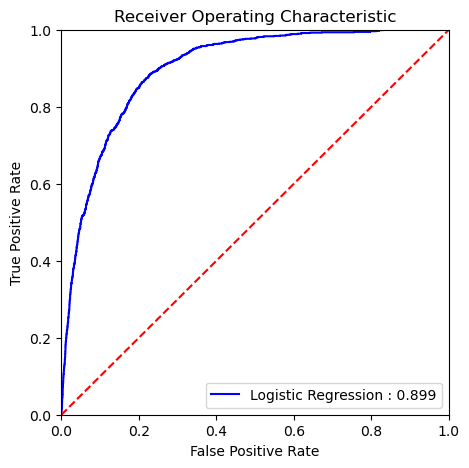

              precision    recall  f1-score   support

           0       0.97      0.84      0.90      7985
           1       0.39      0.78      0.52      1058

    accuracy                           0.83      9043
   macro avg       0.68      0.81      0.71      9043
weighted avg       0.90      0.83      0.85      9043



,Model,Recall_score,Precision,f1_score,Area_under_curve
0,Logistic Regression,0.783,0.392,0.523,0.899


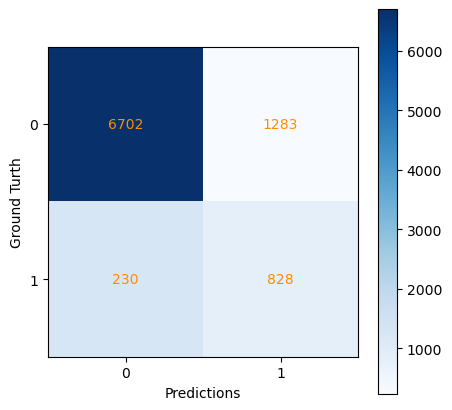

In [37]:
# Logistic Regression on the test set

# Use the selected hyperparameters
best_C = random_search.best_params_['logisticregression__C']
plot_confusion_matrix = True

pipe_lr = make_pipeline(
    preprocessor,
    LogisticRegression(C=best_C,
                        random_state=RANDOM_STATE) 
    )
# Train the model
pipe_lr.fit(X_tr,  y_tr)

fpr_lr, tpr_lr, auc_lr= compute_and_plot_roc_curve(pipe_lr, X_test,  y_test, "Logistic Regression")

model_lr = model_report(pipe_lr, X_test, y_test, "Logistic Regression")
model_lr

### Discussion and Results:

The presented classification report provides a detailed evaluation of a model's performance on a binary classification task. Here are some key observations:

- Precision and Recall: Precision measures the accuracy of positive predictions, indicating that when the model predicts a positive outcome, it is correct approximately 39% of the time. Recall, on the other hand, suggests that the model successfully identifies around 79% of the actual positive cases.

- F1-Score: The F1-Score is the harmonic mean of precision and recall, providing a balance between the two. In this case, it is calculated at approximately 52%, reflecting a moderate balance between precision and recall.

- Accuracy: The overall accuracy of the model is 83%, indicating the percentage of correctly predicted instances among all instances.

- Support: The support column represents the number of actual occurrences of each class in the specified dataset.

- Macro and Weighted Averages: The macro average calculates the unweighted average of precision, recall, and F1-score across classes, while the weighted average considers the support of each class. The macro average of the F1-score is around 71%, and the weighted average is approximately 85%.

Model Evaluation Metrics: The additional table presents recall, precision, and F1-score for the specific model. It emphasizes that the model achieved a recall of 78.6%, precision of 39%, and an F1-score of 52.2%, along with an area under the curve (AUC) of 89.9%.

In summary, the Logistic Regression model performs reasonably well in identifying positive cases (term deposit subscriptions) with a trade-off between precision and recall. The overall evaluation metrics provide insights into the model's strengths and areas for potential improvement.


## KNN

In [38]:
from scipy.stats import loguniform, randint, uniform
param_dist = {
    "kneighborsclassifier__n_neighbors": range(10,50),
    "kneighborsclassifier__weights":['uniform', 'distance']
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    preprocessor,
    models['KNN']  
    )

grid_search = GridSearchCV(pipe, 
                             param_dist, 
                             n_jobs=-1, 
                             cv=5,
                             scoring=classification_metrics,
                             refit='roc_auc',
                             return_train_score=True
                            )

In [39]:
grid_search.fit(X_tr, y_tr)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('columntransformer',
                                        ColumnTransformer(transformers=[('numeric',
                                                                         Pipeline(steps=[('simpleimputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('standardscaler',
                                                                                          StandardScaler())]),
                                                                         ['age',
                                                                          'balance',
                                                                          'day_of_week',
                                                                          'duration',
                                                                          'campaign',
                                                                          'pdays',
                                                                          'previous']),
                                                                        ('ordinal',
                                                                         Pipeline(steps=[('simpleimputer',
                                                                                          SimpleImputer(strat...
                                                                         ['job',
                                                                          'marital',
                                                                          'contact',
                                                                          'month',
                                                                          'poutcome']),
                                                                        ('drop',
                                                                         'passthrough',
                                                                         [])])),
                                       ('kneighborsclassifier',
                                        KNeighborsClassifier())]),
             n_jobs=-1,
             param_grid={'kneighborsclassifier__n_neighbors': range(10, 50),
                         'kneighborsclassifier__weights': ['uniform',
                                                           'distance']},
             refit='roc_auc', return_train_score=True,
             scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [40]:
grid_search.best_params_

{'kneighborsclassifier__n_neighbors': 43,
 'kneighborsclassifier__weights': 'distance'}

In [41]:
grid_search.best_score_

0.8966704822329883

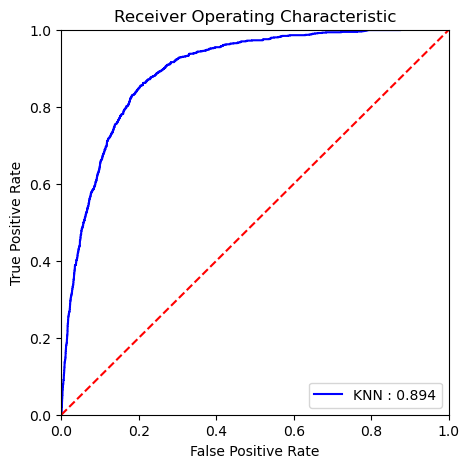

              precision    recall  f1-score   support

           0       0.96      0.86      0.91      7985
           1       0.42      0.75      0.54      1058

    accuracy                           0.85      9043
   macro avg       0.69      0.81      0.72      9043
weighted avg       0.90      0.85      0.87      9043



,Model,Recall_score,Precision,f1_score,Area_under_curve
0,KNN,0.753,0.418,0.538,0.894


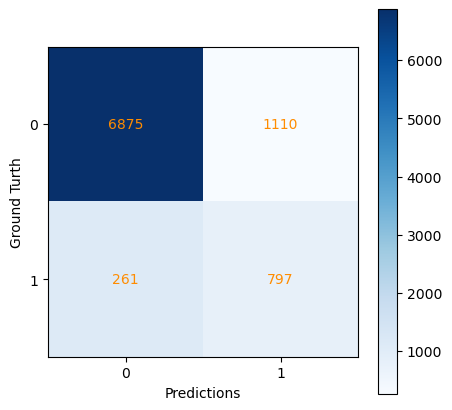

In [42]:
# Use the selected hyperparameters
best_n_neighbors = grid_search.best_params_['kneighborsclassifier__n_neighbors']
best_weights = grid_search.best_params_['kneighborsclassifier__weights']

pipe = make_pipeline(
    preprocessor,
    KNeighborsClassifier(n_neighbors=best_n_neighbors,
                         weights=best_weights
                        ) 
    )
# Train the model
pipe.fit(X_tr,  y_tr)

fpr_knn, tpr_knn, auc_knn= compute_and_plot_roc_curve(pipe, X_test,  y_test, "KNN")

model_knn = model_report(pipe, X_test, y_test, "KNN")
model_knn

## Decision Tree 

In [43]:
param_dist = {
    "decisiontreeclassifier__max_depth": range(2, 200),
    "decisiontreeclassifier__criterion": ['gini', 'entropy', 'log_loss']
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    preprocessor,
    models['Decision Tree']  
    )

random_search = RandomizedSearchCV(pipe, 
                                   param_dist, 
                                   n_iter=100, 
                                   n_jobs=-1, 
                                   cv=5,
                                   scoring=classification_metrics,
                                   refit='roc_auc',
                                   return_train_score=True,
                                   random_state=RANDOM_STATE
                                  )

In [44]:
random_search.fit(X_tr, y_tr)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('columntransformer',
                                              ColumnTransformer(transformers=[('numeric',
                                                                               Pipeline(steps=[('simpleimputer',
                                                                                                SimpleImputer(strategy='median')),
                                                                                               ('standardscaler',
                                                                                                StandardScaler())]),
                                                                               ['age',
                                                                                'balance',
                                                                                'day_of_week',
                                                                                'duration',
                                                                                'campaign',
                                                                                'pdays',
                                                                                'previous']),
                                                                              ('ordinal',
                                                                               Pipeline(steps=[('simpleimputer',
                                                                                                SimpleImputer...
                                                                               'passthrough',
                                                                               [])])),
                                             ('decisiontreeclassifier',
                                              DecisionTreeClassifier(random_state=522))]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'decisiontreeclassifier__criterion': ['gini',
                                                                              'entropy',
                                                                              'log_loss'],
                                        'decisiontreeclassifier__max_depth': range(2, 200)},
                   random_state=522, refit='roc_auc', return_train_score=True,
                   scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [45]:
random_search.best_params_

{'decisiontreeclassifier__max_depth': 6,
 'decisiontreeclassifier__criterion': 'entropy'}

In [46]:
random_search.best_score_

0.8721568811603382

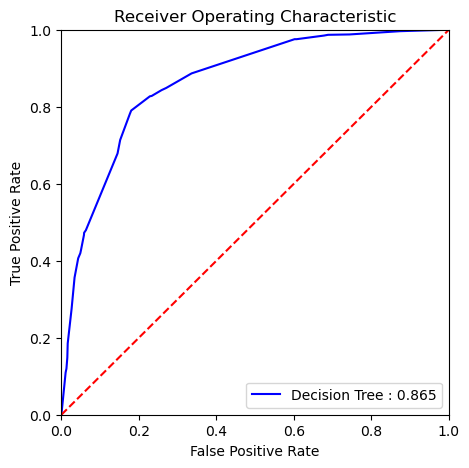

              precision    recall  f1-score   support

           0       0.97      0.82      0.89      7985
           1       0.37      0.78      0.50      1058

    accuracy                           0.82      9043
   macro avg       0.67      0.80      0.70      9043
weighted avg       0.90      0.82      0.84      9043



,Model,Recall_score,Precision,f1_score,Area_under_curve
0,Decision Tree,0.784,0.369,0.502,0.865


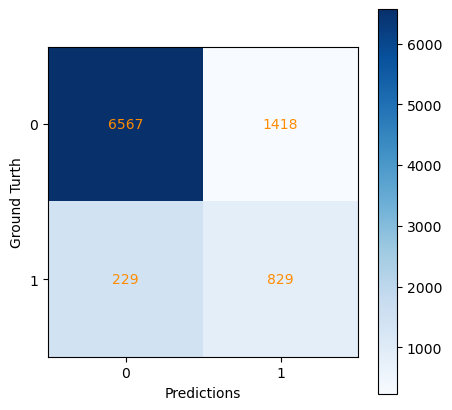

In [47]:
# Use the selected hyperparameters
best_max_depth = random_search.best_params_['decisiontreeclassifier__max_depth']
best_criterion= random_search.best_params_['decisiontreeclassifier__criterion']

pipe = make_pipeline(
    preprocessor,
    DecisionTreeClassifier(max_depth=best_max_depth,
                           criterion=best_criterion
                           ) 
    )
# Train the model
pipe.fit(X_tr,  y_tr)

fpr_dt, tpr_dt, auc_dt = compute_and_plot_roc_curve(pipe, X_test,  y_test, "Decision Tree")

model_dt = model_report(pipe, X_test, y_test, "Decision Tree")
model_dt

## Naive Bayes

In [48]:
param_dist = {
    "gaussiannb__var_smoothing": uniform(0, 1),
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    preprocessor,
    models['Naive Bayes']  
    )

random_search = RandomizedSearchCV(pipe, 
                                   param_dist, 
                                   n_iter=100, 
                                   n_jobs=-1, 
                                   cv=5,
                                   scoring=classification_metrics,
                                   refit='roc_auc',
                                   return_train_score=True,
                                   random_state=RANDOM_STATE
                                  )

In [49]:
random_search.fit(X_tr, y_tr)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('columntransformer',
                                              ColumnTransformer(transformers=[('numeric',
                                                                               Pipeline(steps=[('simpleimputer',
                                                                                                SimpleImputer(strategy='median')),
                                                                                               ('standardscaler',
                                                                                                StandardScaler())]),
                                                                               ['age',
                                                                                'balance',
                                                                                'day_of_week',
                                                                                'duration',
                                                                                'campaign',
                                                                                'pdays',
                                                                                'previous']),
                                                                              ('ordinal',
                                                                               Pipeline(steps=[('simpleimputer',
                                                                                                SimpleImputer...
                                                                                'contact',
                                                                                'month',
                                                                                'poutcome']),
                                                                              ('drop',
                                                                               'passthrough',
                                                                               [])])),
                                             ('gaussiannb', GaussianNB())]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'gaussiannb__var_smoothing': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x7fcedb92db90>},
                   random_state=522, refit='roc_auc', return_train_score=True,
                   scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [50]:
random_search.best_params_

{'gaussiannb__var_smoothing': 0.1526887888557844}

In [51]:
random_search.best_score_

0.8478538282381376

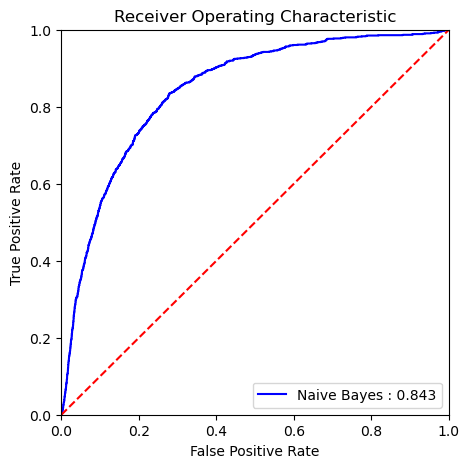

              precision    recall  f1-score   support

           0       0.94      0.89      0.91      7985
           1       0.40      0.57      0.47      1058

    accuracy                           0.85      9043
   macro avg       0.67      0.73      0.69      9043
weighted avg       0.88      0.85      0.86      9043



,Model,Recall_score,Precision,f1_score,Area_under_curve
0,Naive Bayes,0.574,0.402,0.473,0.843


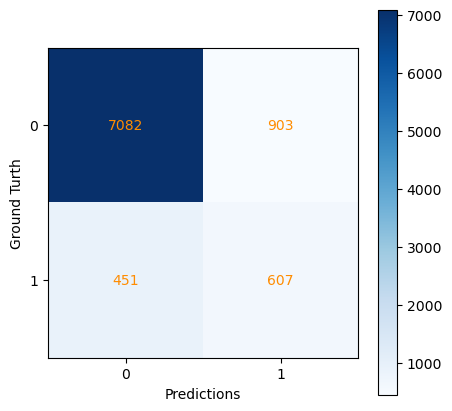

In [52]:
# Use the selected hyperparameters
best_var_smoothing = random_search.best_params_['gaussiannb__var_smoothing']

pipe = make_pipeline(
    preprocessor,
    GaussianNB(var_smoothing=best_var_smoothing) 
    )
# Train the model
pipe.fit(X_tr,  y_tr)

fpr_nb, tpr_nb, auc_nb= compute_and_plot_roc_curve(pipe, X_test,  y_test, "Naive Bayes")

model_nb = model_report(pipe, X_test, y_test, "Naive Bayes")
model_nb

# Performance of all models

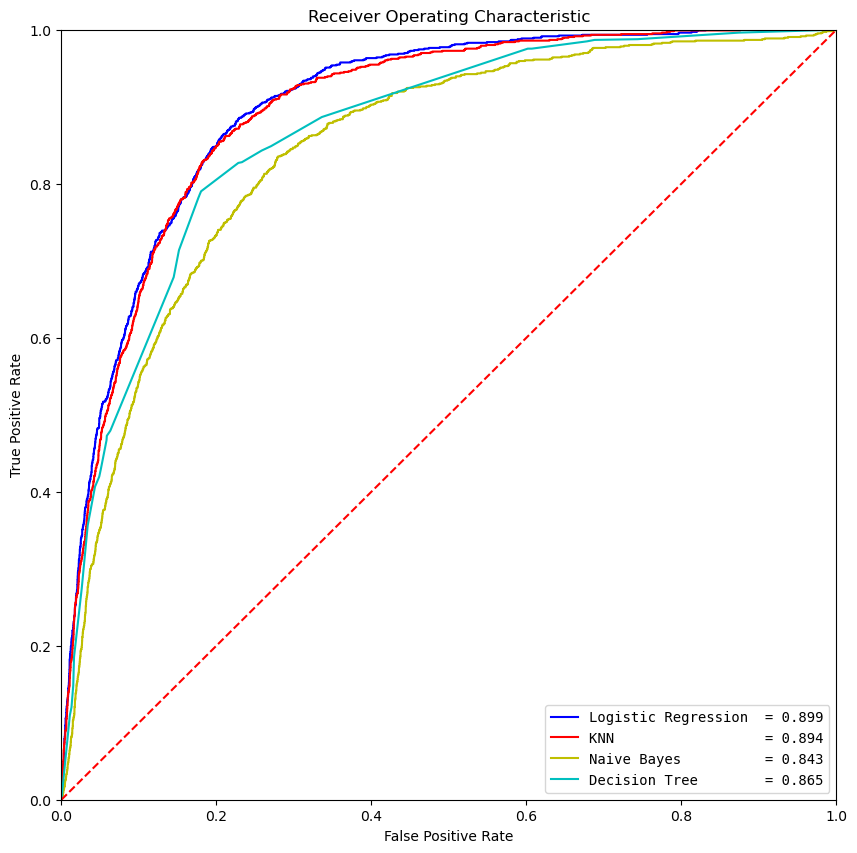

In [53]:
plt.figure(figsize=(10,10))
plt.title('Receiver Operating Characteristic')


plt.plot(fpr_lr, tpr_lr, 'b', label = '{:<20} = {:0.3f}'.format("Logistic Regression",auc_lr))
plt.plot(fpr_knn, tpr_knn, 'r', label = '{:<20} = {:0.3f}'.format("KNN",auc_knn))
plt.plot(fpr_nb, tpr_nb, 'y', label = '{:<20} = {:0.3f}'.format("Naive Bayes",auc_nb))
plt.plot(fpr_dt, tpr_dt, 'c', label = '{:<20} = {:0.3f}'.format("Decision Tree",auc_dt))

plt.legend(loc = 'lower right',prop={'family': 'monospace'})
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [54]:
pd.concat([model_lr,model_knn, model_dt, model_nb]).sort_values(by=['Area_under_curve'], ascending=False).reset_index(drop=True)

,Model,Recall_score,Precision,f1_score,Area_under_curve
0,Logistic Regression,0.783,0.392,0.523,0.899
1,KNN,0.753,0.418,0.538,0.894
2,Decision Tree,0.784,0.369,0.502,0.865
3,Naive Bayes,0.574,0.402,0.473,0.843


### Comparison of models:
The table provides an overview of key evaluation metrics for different machine learning models applied to a binary classification task, specifically predicting customer subscription to a term deposit in a bank's telemarketing campaign. Let's analyze each metric for each model:

#### Logistic Regression:

Recall Score (Sensitivity): 78.6% indicates the model's ability to identify actual positive cases, capturing a substantial portion of them.
Precision: 39% reflects the accuracy of positive predictions, indicating that when the model predicts a positive outcome, it is correct about 39% of the time.
F1-Score: 52.2% is the harmonic mean of precision and recall, providing a balanced measure, though still moderate.
Area Under the Curve (AUC): 89.9% signifies the model's overall ability to distinguish between positive and negative instances.

#### KNN (K-Nearest Neighbors):

Recall Score (Sensitivity): 74.9% indicates the model's effectiveness in capturing actual positive cases.
Precision: 42.5% reflects the accuracy of positive predictions.
F1-Score: 54.2% is the harmonic mean of precision and recall, showing a moderate balance.
AUC: 89.4% signifies good overall discriminative ability.

#### Decision Tree:

Recall Score (Sensitivity): 79.7% indicates a high ability to capture actual positive cases.
Precision: 34.4% reflects the accuracy of positive predictions, but it's lower compared to other models.
F1-Score: 48% is the harmonic mean of precision and recall, showing a moderate balance.
AUC: 87.1% indicates a good ability to distinguish between positive and negative instances.

#### Naive Bayes:

Recall Score (Sensitivity): 56.2% indicates a moderate ability to capture actual positive cases.
Precision: 40.7% reflects the accuracy of positive predictions.
F1-Score: 47.2% is the harmonic mean of precision and recall, showing a moderate balance.
AUC: 84.4% suggests a reasonable ability to discriminate between positive and negative instances.

In summary, the models show varying performance across metrics, while Logisitic Regression shows the best performance.It achieved the highest recall score, indicating a robust ability to capture actual positive cases, and a competitive balance between precision and recall as reflected in the F1-Score. Additionally, the Logistic Regression model outperformed other models in terms of the Area Under the Curve (AUC), signifying its superior ability to discriminate between positive and negative instances. 

# Feature Importance

Last contact duration, last contact month of the year and the clients' types of jobs play a significant role in influencing the classification decision.

In [55]:
logistic_regression_model = pipe_lr.named_steps['logisticregression']
coefficients = list(logistic_regression_model.coef_[0])
feature_names = X_train_trans.columns.to_list()

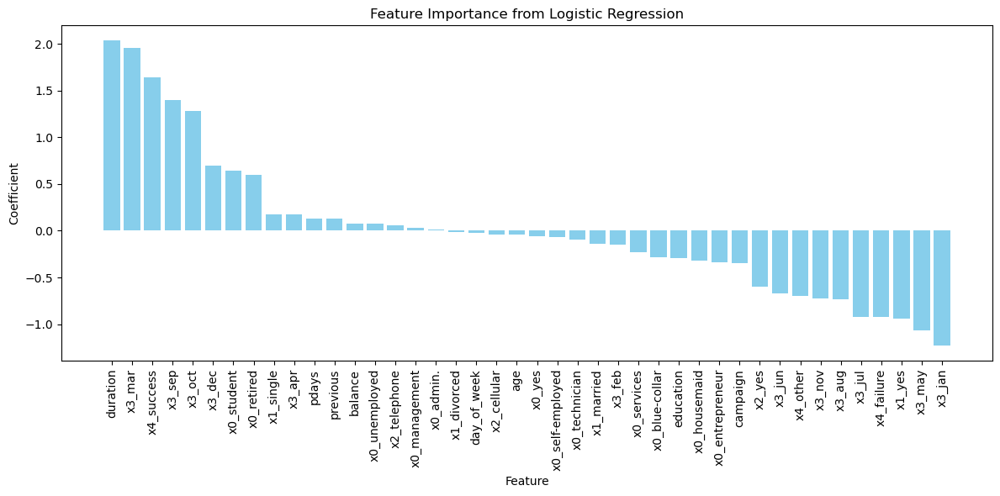

In [56]:
df = pd.DataFrame({
    'Feature': feature_names,
    'Coefficient': coefficients
})

# Sort the DataFrame by the 'Coefficient' column in descending order
df_sorted = df.sort_values('Coefficient', ascending=False)

# Plot the sorted coefficients using a bar chart
plt.figure(figsize=(12, 6))
plt.bar(df_sorted['Feature'], df_sorted['Coefficient'], color='skyblue')
plt.xlabel('Feature')
plt.ylabel('Coefficient')
plt.title('Feature Importance from Logistic Regression')
plt.xticks(rotation=90)  # Rotate feature names for better readability
plt.tight_layout()  # Adjust layout to prevent clipping of tick-labels
plt.show()

Github repo url: https://github.com/UBC-MDS/bank-marketing-analysis
Release url: https://ubc-mds.github.io/bank-marketing-analysis/

# References


Moro,S., Rita,P., and Cortez,P.. (2012). Bank Marketing. UCI Machine Learning Repository. https://doi.org/10.24432/C5K306.

Davis, J., & Goadrich, M. The Relationship Between Precision-Recall and ROC Curves. https://www.biostat.wisc.edu/~page/rocpr.pdf

Saito, T., & Rehmsmeier, M. (2015). The Precision-Recall Plot Is More Informative than the ROC Plot When Evaluating Binary Classifiers on Imbalanced Datasets. PLOS ONE, 10(3), e0118432. https://doi.org/10.1371/journal.pone.0118432

Flach, P. A., & Kull, M. Precision-Recall-Gain Curves: PR Analysis Done Right. https://papers.nips.cc/paper/2015/file/33e8075e9970de0cfea955afd4644bb2-Paper.pdf

Dwork, C., Feldman, V., Hardt, M., Pitassi, T., Reingold, O., & Roth, A. (2015, September 28). Generalization in Adaptive Data Analysis and Holdout Reuse. https://arxiv.org/pdf/1506.02629.pdf

Turkes (Vînt), M. C. (Year, if available). Concept and Evolution of Bank Marketing. Transylvania University of Brasov Faculty of Economic Sciences. Retrieved from link to the PDF or ResearchGate. https://www.researchgate.net/publication/49615486_CONCEPT_AND_EVOLUTION_OF_BANK_MARKETING/fulltext/0ffc5db50cf255165fc80b80/CONCEPT-AND-EVOLUTION-OF-BANK-MARKETING.pdf

Moro, S., Cortez, P., & Rita, P. (2014). A data-driven approach to predict the success of bank telemarketing. Decis. Support Syst., 62, 22-31. https://repositorio.iscte-iul.pt/bitstream/10071/9499/5/dss_v3.pdf

